# OCR справок о донорстве крови

Импортируем используемые в проекте библиотеки и модули.

In [119]:
# использумеые библиотеки
import os
import cv2
import pandas as pd
import numpy as np
import statistics 
import warnings 
from matplotlib import pyplot as plt
from PIL import Image as PILImage
from transformers import DetrImageProcessor, DetrForObjectDetection 
from img2table.ocr import EasyOCR
from img2table.ocr import TesseractOCR
from img2table.document import Image
from tabulate import tabulate
from IPython.display import display_html
from skimage.morphology import disk
from skimage.filters import threshold_otsu, rank

# класс распознавания таблицы
import TableExtractor_original as te_or
import TableExtractor as te  
import TableExtractor0 as te0 
import TableExtractor01 as te01
import TableExtractor1 as te1

# класс, который переводит таблицу в формат csv
import TableToCsv as ta

warnings.filterwarnings("ignore")

In [2]:
# папка с файлами заказчика
original_dir='images_form_405/' 

# папка с результатами работы TesseractOCR
tesseract = r'results/read_table/table_'

# результаты работы класса TableExtractor
results_te = r'results/te/'

# результаты работы класса TableExtractor1
results_te1 = r'results/te1/'

# пути к изображениям
paths_images = [original_dir + i for i in os.listdir(original_dir) if 'jpg' in i]

In [4]:
# переименовываю файлы для удобства
try:
    l = [i for i in os.listdir('images_form_405/') if 'jpg' in i]
    for i in range(len(l)):
        os.rename('images_form_405/' + l[i], 'images_form_405/' + f'{i}.jpg')
except:
    pass

## Ход работы: эксперименты

Мы начали выполнение проекта с тестирования работы библиотеки `img2table` с поддержкой `TesseractOCR`. Данное решение показывало такие резульаты.

ПРИМЕР №1
Исходное изображение с разметкой найденных ячеек таблицы


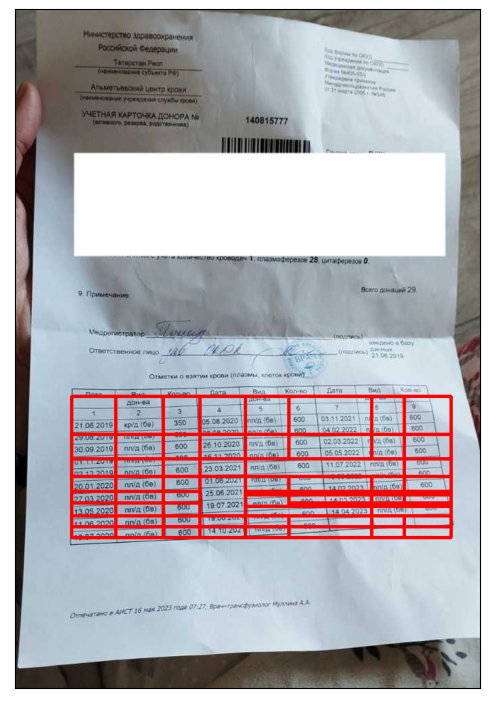

Считанная таблица
    т             2       Е  Unnamed: 3    Unnamed: 4    1       Unnamed: 6    Е.1
    21.06.2019                                           5
                                                         =
--  ------------  ----  ---  ------------  ------------  ------  ------------  -----
 0  30092019      (68)  nan  25102020      (68)          262002  66)           nan
                  (65)
 1  nan           nan   nan  nan           5             nan     nan           nan
 2  [20.1.2020    nan   nan  25062071      [             140225  nan           nan
                             19072021                    800
 3  27.03.2020    (68)  nan  nan           nan           nan     nan           \
 4  nan           nan   nan  nan           nan           nan     nan           nan
 5  13.05.2020]   nan   nan  nan           nan           nan     nan           nan
 6  nan           nan   nan  nan           nan           nan     nan           nan
 7  nan           nan   800  1908

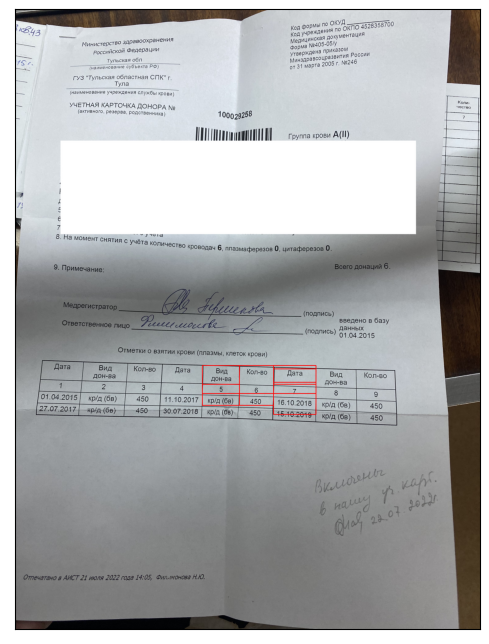

Считанная таблица
    Unnamed: 0      Кол-во  Unnamed: 2
--  ------------  --------  ------------
 0  nan                nan  Дата
 1  nan                nan  nan
 2  nan                nan  nan
 3  кр/д               nan  nan


ПРИМЕР №3
Исходное изображение с разметкой найденных ячеек таблицы


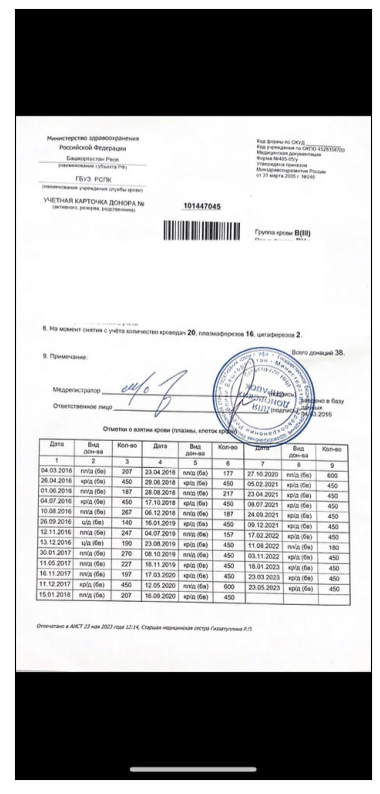

Считанная таблица



ПРИМЕР №4
Исходное изображение с разметкой найденных ячеек таблицы


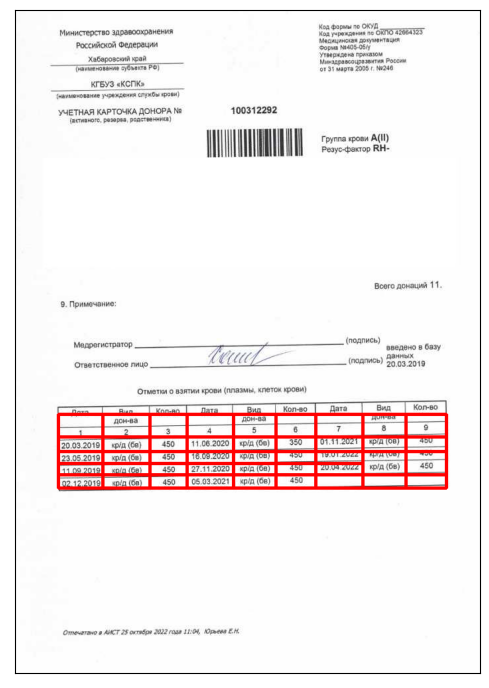

Считанная таблица
    т            2       Unnamed: 2  Unnamed: 3    Unnamed: 4      Unnamed: 5    т.1  Unnamed: 7    Unnamed: 8
--  -----------  ----  ------------  ------------  ------------  ------------  -----  ------------  ------------
 0  nan          (68)           nan  nan           (69)                   350    nan  (68)          450
 1  23.05.2019   nan            450  16.09.2020    nan                    450    nan  (68)          450
                                                                                      (68)          450
 2  nan          nan            nan  nan           (68)                   450    nan  nan           nan
 3  [02.12.2019  nan            nan  05.03.2021    nan                    450    nan  nan           nan




In [3]:
ocr = TesseractOCR(n_threads=1, lang="rus")

# Instantiation of document, either an image or a PDF
k = 1
for i in [0, 1, 11, 13]:
    image_path = paths_images[i]
    image = Image(src=image_path, detect_rotation=False)
    extracted_tables = image.extract_tables(ocr=ocr,
                                          implicit_rows=False,
                                          borderless_tables=False,
                                          min_confidence=50)
    
    #extracted_tables = image.extract_tables()
    original_img_bgr = cv2.imdecode(np.fromfile(image_path, dtype=np.uint8), cv2.IMREAD_COLOR)
    original_img_rgb = cv2.cvtColor(original_img_bgr, cv2.COLOR_BGR2RGB)
    for table in extracted_tables:
        for row in table.content.values():
            for cell in row:
                cv2.rectangle(original_img_rgb, (cell.bbox.x1, cell.bbox.y1), (cell.bbox.x2, cell.bbox.y2), (255, 0, 0), 3)

    print(f'ПРИМЕР №{k}')
    k += 1
    print('Исходное изображение с разметкой найденных ячеек таблицы')
    plt.figure(figsize=(6, 10))
    plt.imshow(PILImage.fromarray(original_img_rgb))
    plt.xticks([])
    plt.yticks([])
    plt.show()
    
    print('Считанная таблица')
    path_table = tesseract + f'{i}.xlsx'
    image.to_xlsx(path_table,
                ocr=ocr,
                implicit_rows=False,
                borderless_tables=False,
                min_confidence=50)
    df = pd.read_excel(path_table)
    print(tabulate(df, headers='keys'))
    
    print('\n')

По данным примерам видно следующее.
* `img2table` не учитывает наклон таблиц на изображениях и следовательно неправильно такие таблицы размечает. Даже самый небольшой наклон даёт не позволяет `img2table` корректно разметить таблицу.
* Даже на изображениях хорошего качества, на которых таблица никак не наклонена `img2table` может не найти таблицу.
* `TesseractOCR` достаточно хорошо считывает с изображения числовые данные, но не буквенный текст, что хорошо видно в последнем примере.

Отсюда мы сделали выводы, что необходимо заняться в певую очередь предобработкой изображения, а затем уже считывать данные в таблицу. 


В процессе поисков различных методов предобработки мы попробовали следующее:
- увеличение яркости и контрастности изображения;
- повышение чёткости изображения;
- удаление шумов с изображения;
- удаление печатей с изображений;
- различные методы бинаризации изображений.

Рассмотрим, как мы эксперементировали с этими этапами предобработки изображений. Но для начала считаем все изображения.

In [105]:
dirname = 'images_form_405'
ext = ('.jpg')
images = []
for img in os.listdir(dirname):
    if img.endswith(ext):
        image = cv2.imdecode(np.fromfile(original_dir + '\\' + img, dtype=np.uint8), cv2.IMREAD_COLOR)
        images.append(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

### 1. Улучшение яркости и контрастности

Поскольку многие из предоставленных заказчиком изображений были достаточно тёмными, мы начали с того чтобы сделать их более яркими и контрастными. Для этого была написана пользовательская функция `set_contrast_and_brightness`, в основу которой легла функция `cv2.convertScaleAbs` библиотеки `OpenCV`. 

In [5]:
def set_contrast_and_brightness(image):
    med = np.median(image)
    if med <= 100:
        d = 64
    elif 100 < med < 180:
        d = 45
    else:
        d = 25
    # alpha управляет контрастностью
    alpha = 1 + round(d / med, 1) 
    # beta управляет яркостью
    beta = round((255 - med) / 2)
    img = cv2.convertScaleAbs(image, alpha=alpha, beta=beta)
    return img

Чтобы эта функция правильно работала со всеми изображениями, мы вывели простые формулы, которые для каждого изображения вычисляют оптимальные значения коэффициентов, отвечающих за яркость и контрастность. Такая настройка коэффициентов позволяет делать тёмные изображения светлее, а светлые изображения не высветлять до такой степень, что текст на них уже не будет читаться.

Посмотрим, как эта функция работает с размыми изображениями.

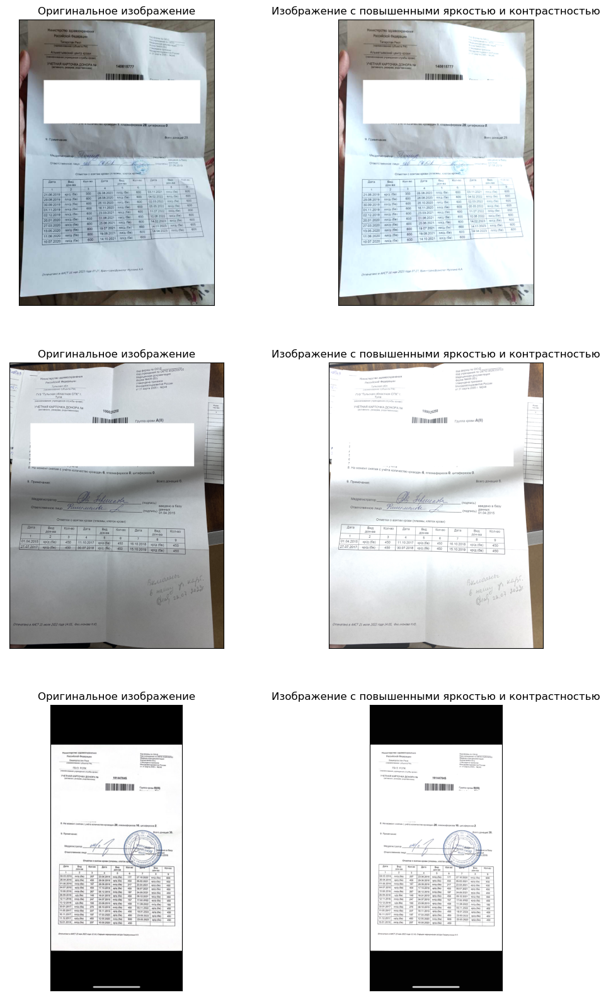

In [6]:
fig = plt.figure(figsize=(12, 20))
k=1
for i in [0, 1, 11]:    
    fig.add_subplot(3, 2, k)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title('Оригинальное изображение')
    k += 1
    
    fig.add_subplot(3, 2, k)
    plt.imshow(PILImage.fromarray(set_contrast_and_brightness(images[i])))
    plt.xticks([])
    plt.yticks([])
    plt.title('Изображение с повышенными яркостью и контрастностью') 
    k += 1

В итоге получили, что функция работает так, как задумано: тёмные изображения она делает более яркими и контрастными, а светлые изображения практически не изменяет.

### 2. Повышение чёткости изображения

Чтобы сделать изображение более чётким, была написана функция `improved_image_clarity`. В её основу легла функция `cv2.filter2D` библиотеки `OpenCV`, которая служит для применения различных фультров к изображениям. Мы её использовали для повышения резкости изображения, передав этой функции соответствующее ядро.

In [7]:
def improved_image_clarity(image):
    # Ядро для улучшения чёткости изображения
    kernel = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
    img = cv2.filter2D(image, -1, kernel)
    return img

Посмотрим, как эта функция работает.

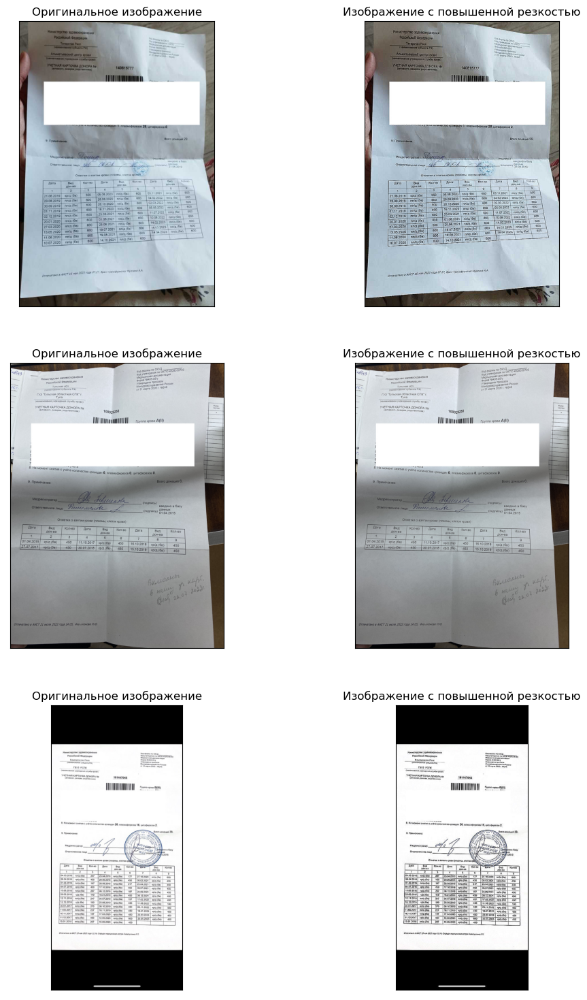

In [8]:
fig = plt.figure(figsize=(12, 25))
k=1
for i in [0, 1, 11]:    
    fig.add_subplot(4, 2, k)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title('Оригинальное изображение')
    k += 1
    
    fig.add_subplot(4, 2, k)
    plt.imshow(PILImage.fromarray(improved_image_clarity(images[i])))
    plt.xticks([])
    plt.yticks([])
    plt.title('Изображение с повышенной резкостью')
    k += 1

Видим, что после примения данной функции текст на изображениях стал более чётким, особенно это заметно в первом примере. А вот на изображения, на которых текст и так было довольно хорошего качества, данная функция не оказала сильного влияния, что видно на втором примере.

В итоговом решениие мы объединили функции `set_contrast_and_brightness` и `improved_image_clarity` в одну под названием `improved_image`.

### 3. Удаление шумов

Мы также эксперементировали с удалением шумов (мелких точек, неровностей листа на фотографии и т.п.) с изображения, для того использовали функцию `fastNlMeansDenoisingColored` библиотеки `OpenCV`. Здесь важно было подобрать такое значения параметра `h`, которое бы не удаляло мелкие детали изображения, такие как текст, при удалении шумов. 

Рассмотрим на примере, как различные значения параметра `h` функции `fastNlMeansDenoisingColored` влияют на изображение; остальные параметры функции не так сильно влияют на удаление шумов, поэтому их не рассматриваем.

In [9]:
def remove_noise(image, h):
    return cv2.fastNlMeansDenoisingColored(image, None, h, 5)

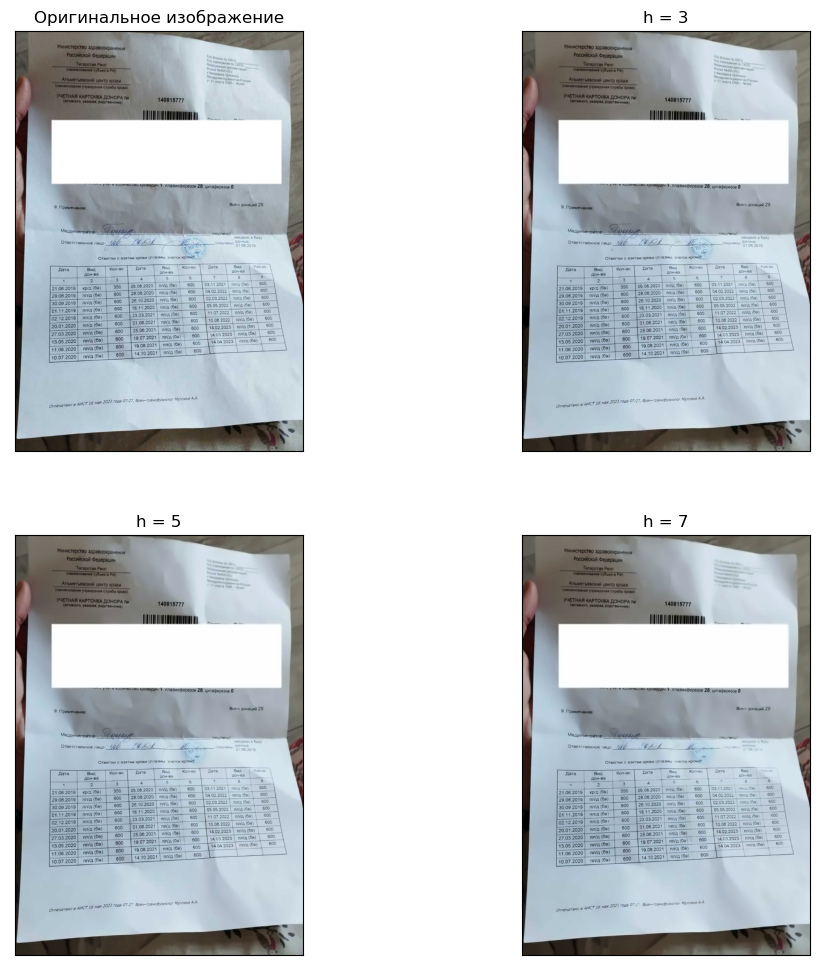

In [10]:
fig = plt.figure(figsize=(12, 12))
k = 1

fig.add_subplot(2, 2, k)
plt.imshow(PILImage.fromarray(images[0]))
plt.xticks([])
plt.yticks([])
plt.title('Оригинальное изображение')

k +=1
for h in [3, 5, 7]:
    img = remove_noise(images[0], h)
    fig.add_subplot(2, 2, k)
    plt.imshow(PILImage.fromarray(img))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'h = {h}')

    k += 1

Видим, что при значение `h` больше 5, часть текста на изображение удаляется, поэтому параметр `h` мы взяли равным 5.

### 4. Бинаризация изображения

Далее мы пробовали применять к изображениям различные методы бинаризации. Под каждый из этих методов мы написала отдельную функцию. Посмотрим на результат работы этих функций с различными изображениями, а также сравним их работу в случаях, когда им передают исходное изображение и улучшенное с помощью ранее представленных функций. Методы бинаризации работают с изображениями в градациях серого цвета, поэтому снача необходимо перевести изображение в серую цветовую палитру.

In [11]:
# Функция для улучшения качества изображения
def image_quality_improvement(image):
    img = set_contrast_and_brightness(image)
    img = improved_image_clarity(img)
    img = remove_noise(img, h=5)
    return img

# Функции бинаризации изображения
def threshold_local(img, radius=15):
    selem = disk(radius)
    local_otsu = rank.otsu(img, selem)
    imgL = (img >= local_otsu)
    return imgL

def threshold_global(img):
    threshold_global_otsu = threshold_otsu(img)
    imgG = img >= threshold_global_otsu
    return imgG

def adaptive_threshold_gaussian(image):
    img = cv2.adaptiveThreshold(image, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 35, 35)
    return img

def threshold_otsu(image):
    _, img = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    return img

def threshold_binary(image):
    _, img = cv2.threshold(image, 127, 255, cv2.THRESH_BINARY)
    return img

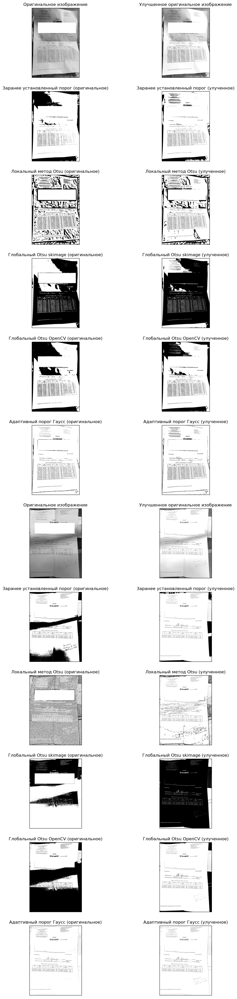

In [12]:
fig = plt.figure(figsize=(12, 50))
k=1
for i in [0, 1]: 
    img = cv2.cvtColor(images[i], cv2.COLOR_RGB2GRAY)
    img_imp = cv2.cvtColor(image_quality_improvement(images[i]), cv2.COLOR_RGB2GRAY)
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(img), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Оригинальное изображение')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(img_imp), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Улучшенное оригинальное изображение')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(threshold_binary(img)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Заранее установленный порог (оригинальное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(threshold_binary(img_imp)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Заранее установленный порог (улученное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(threshold_local(img)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Локальный метод Otsu (оригинальное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(threshold_local(img_imp)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Локальный метод Otsu (улученное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(threshold_global(img)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Глобальный Otsu skimage (оригинальное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(threshold_global(img_imp)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Глобальный Otsu skimage (улученное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(threshold_otsu(img)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Глобальный Otsu OpenCV (оригинальное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(threshold_otsu(img_imp)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Глобальный Otsu OpenCV (улученное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(adaptive_threshold_gaussian(img)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Адаптивный порог Гаусс (оригинальное)')
    k += 1
    
    fig.add_subplot(12, 2, k)
    plt.imshow(PILImage.fromarray(adaptive_threshold_gaussian(img_imp)), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title('Адаптивный порог Гаусс (улученное)')
    k += 1

Видим, что лучший результат даёт бинаризация улучшенного исходного изображения с помощью адаптивного порога Гаусса. В остальных случаях на изображениях появляются какие-то пятна, шумы, удаляется часть текста или часть изображения просто становится чёрной. Поэтому в качестве метода бинаризации в итоговом решении мы использовали адаптивный порог, где порогове значение определяется методом Гаусса (функция `cv2.adaptiveThreshold` библиотеки `OpenCV` с параметром `adaptiveMethod=cv2.ADAPTIVE_THRESH_GAUSSIAN_C`.

### 5. Тестирование класса TableExtractor

Затем в интернете мы нашли класс `TableExtractor` ([репозиторий](https://github.com/livefiredev/ocr-extract-table-from-image-python), откуда был взят класс), который с помощью методов библиотеки `OpenCV` ищет на изображении таблицу и извлекает её.

Посмотрим как работал этот класс до того, как мы его доработали.

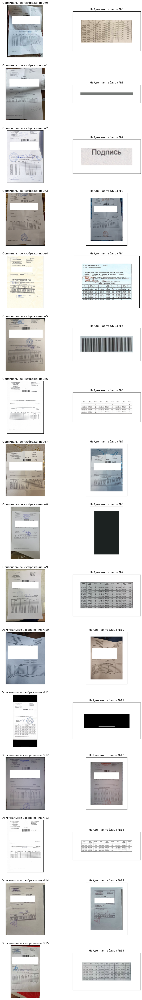

In [13]:
fig = plt.figure(figsize=(12, 80))
for i in range(len(paths_images)):   
    fig.add_subplot(16, 2, (i+1)*2-1)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Оригинальное изображение №{i}')
    
    table_extractor = te_or.TableExtractor(paths_images[i])
    perspective_corrected_image = table_extractor.execute()
    fig.add_subplot(16, 2, (i+1)*2)
    plt.imshow(PILImage.fromarray(perspective_corrected_image), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Найденная таблица №{i}')

Видно, что исходный класс `TableExtractor` извлекает таблицу, не обрезая её, только в 4 случаях из 16, поэтому данный мы решили доработать. Также мы заметили, что данный класс не находит таблицы на всех изображениях, на которых печати заходят на таблицы (изображения 2, 8, 11, 12, 14). Мы предположили, что это связано с тем, что в основе работы этого класса лежит метод нахождения контуров на изображении, и наибольший найденный прямоугольный контур считается таблицей. Соответственно, если контур таблицы нарушен, как в случаях, когда на таблицу заходит печать, то данный метод не находит котур таблицы. Поэтому далее мы улучшили этот класс, добавив в него методы предобработки изображения, которые мы рассматривали ранее, а также методы удаления печатей с изображения.



### 6. Удаление печатей с изображения

Прежде, чем преступить к рассотрению улучшенного класса `TableExtractor`, разберём, как мы эксперементировали с удалением печатей с изображений.

В основе первого тестируемого варианта удаления печатей лежал перевод изображени в цветовое пространство CMYK. Идея заключалась в том, чтобы перевести изображение в CMYK и затем извлечь из него 3 слой, в котором находятся все чёрные и тёмные элементы изображения, в том числе текст. Посмотрим, как данный метод работал.

In [14]:
def to_cmyk(image):
    img = image.astype(np.float64)/255.
    K = 1 - np.max(img, axis=2)
    C = (1-img[...,2] - K)/(1-K)
    M = (1-img[...,1] - K)/(1-K)
    Y = (1-img[...,0] - K)/(1-K)

    CMYK_image = (np.dstack((C,M,Y,K)) * 255).astype(np.uint8)
    black_channel = CMYK_image[:, :, 3]
    
    bin_img = threshold_otsu(black_channel)
    img_out = cv2.bitwise_not(bin_img)
    
    return img_out

C:\Users\katus\AppData\Local\Temp\ipykernel_19228\861602401.py:4: RuntimeWarning: invalid value encountered in divide
  C = (1-img[...,2] - K)/(1-K)
C:\Users\katus\AppData\Local\Temp\ipykernel_19228\861602401.py:5: RuntimeWarning: invalid value encountered in divide
  M = (1-img[...,1] - K)/(1-K)
C:\Users\katus\AppData\Local\Temp\ipykernel_19228\861602401.py:6: RuntimeWarning: invalid value encountered in divide
  Y = (1-img[...,0] - K)/(1-K)


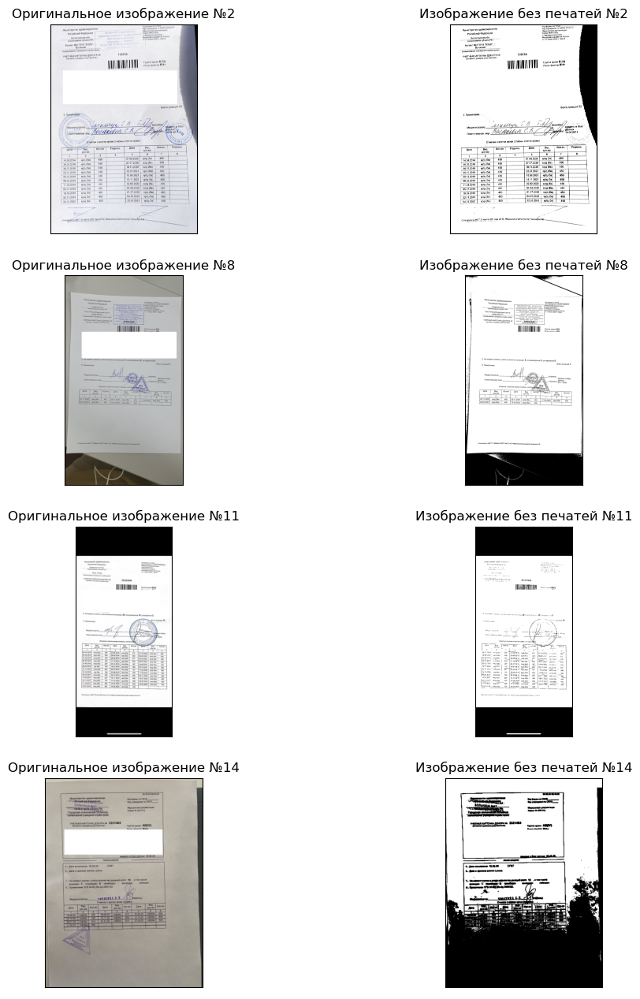

In [15]:
fig = plt.figure(figsize=(12, 20))
k = 1

for i in[2, 8, 11, 14]:
    fig.add_subplot(5, 2, k)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Оригинальное изображение №{i}')
    k += 1
    
    fig.add_subplot(5, 2, k)
    plt.imshow(PILImage.fromarray(to_cmyk(images[i])), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Изображение без печатей №{i}')
    k += 1

Мы показали как работает метод извлечения печатей с использованием цветового пространства CMYK. Видно, что в некоторых случаях этот метод работает достаточно хорошо: на изображении 2 печати практически исчезли. Однако в остальных случаях данный метод либо не работает вовсе (изображении 8), либо стирает часть текста (изображение 11), либо портит изображение в целом (изображения 14). Таким образом, мы отказались от использования этого метода извлечения печатей. 

Далее мы нашли другой способ; он основан на переводе изображения в цветовую модель HLS и извлечении из изображения оттенков синего цвета. 

Мы написала функцию `removing_stamps`, которая реализует данный метод. Она извлекает из изображения в HLS системе пиксели синего цвета (диапазон тона от 90 до 140) различной светлоты и насыщенности; для извлечения пискселей синего цвета используется функция `cv2.inRange` библиотеки `OpenCV`. Здесь перед нами встала задача подобрать пороги светлоты и насыщенности; нижний порог для насыщенности нужен, чтобы не извлекать или тускло-синий и серый цвет, и порог светлоты, чтобы не извлекать черный и белые цвета.

In [16]:
def removing_stamps(image, lightness_min=20, saturation_min=70):
    img = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    denoised = cv2.medianBlur(img, 3)
    gray = cv2.cvtColor(denoised, cv2.COLOR_BGR2GRAY)
    adaptiveThreshold = cv2.mean(img)[0]
    color = cv2.cvtColor(denoised, cv2.COLOR_BGR2HLS)

    mask_gray = cv2.inRange(color, (90, lightness_min, saturation_min), (140, adaptiveThreshold, 255))
    dst = cv2.bitwise_and(gray, gray, mask=mask_gray)

    denoised = cv2.medianBlur(dst, 5)

    blur = cv2.blur(denoised, (3, 3))
    mask = cv2.adaptiveThreshold(blur, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 0)
    mask = cv2.dilate(mask, None, iterations=1)

    image_without_stamps = image.copy()
    image_without_stamps[mask == 255] = np.median(image)
    
    return image_without_stamps

Сначала посмотрим, как нижний порог насыщенности влияет на удаление печатей с изображения. Верхний порог насыщенности установили равным максимальному значению, поскольку нам важен только нижний порог, чтобы не извлекать серые цвета.

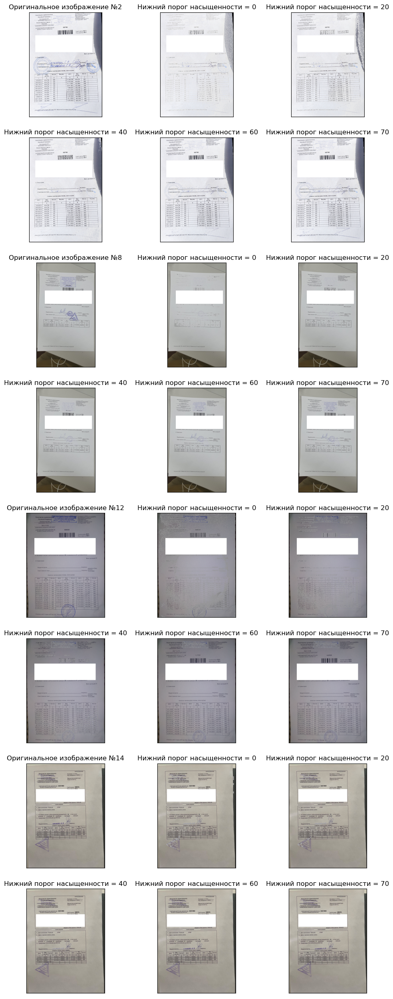

In [17]:
fig = plt.figure(figsize=(12, 40))
k = 1

for i in[2, 8, 12, 14]:
    fig.add_subplot(10, 3, k)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Оригинальное изображение №{i}')
    k += 1
    
    for s_min in [0, 20, 40, 60, 70]:         
        fig.add_subplot(10, 3, k)
        plt.imshow(PILImage.fromarray(removing_stamps(images[i], saturation_min=s_min)), cmap='gray')
        plt.xticks([])
        plt.yticks([])
        plt.title(f'Нижний порог насыщенности = {s_min}')
        k += 1

Видим, что данный метод работает не на всех изображениях: на некоторых он не удаляет печать при любом пороге насыщенности (изображение 14), а на других помимо печати удаляет и текст (изображение 12). Также мы установили, что у всех изображений разный оптимальный нижний порог насыщенности, например, для изображения 2 он равен 40, а для изображения 12 - 70, а для тех изображений где, печатей нет, порог должен быть равен 255 или больше. Нам не удалось вывести формулу, которая расчитывала бы отптимальный порог для каждого изображения, поэтому мы установили нижний порог насыщенности равным 70. При таком значении на некоторых изображениях печати удаляются частично (изображения 2, 8, 12), а на некоторых не удаляются вовсе (изображения 14). Однако те, изображения, на который печати не удаляются, хотя бы не становятся хуже, как это было при использовании метода удаления печатей через перевод изображений в цветовой формат CMYK.

Теперь посмотрим, как нижний порог светлоты влияет на удаление печатей с изображения. Верхний порог светлоты установили равным среднему значению пикселей входного изображения, то есть чем светлее входное изображение, тем выше верхний порог светлоты.

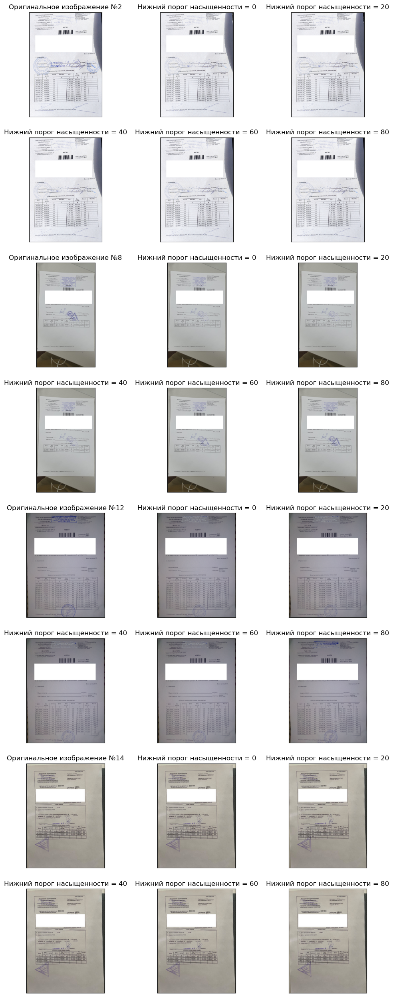

In [18]:
fig = plt.figure(figsize=(12, 40))
k = 1

for i in[2, 8, 12, 14]:
    fig.add_subplot(10, 3, k)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Оригинальное изображение №{i}')
    k += 1
    
    for l_min in [0, 20, 40, 60, 80]:         
        fig.add_subplot(10, 3, k)
        plt.imshow(PILImage.fromarray(removing_stamps(images[i], lightness_min=l_min)), cmap='gray')
        plt.xticks([])
        plt.yticks([])
        plt.title(f'Нижний порог насыщенности = {l_min}')
        k += 1

Видим, что есть случаи, когда порог насыщенности не влияет на удаление печатей (изображения 2, 14), а есть случаи, когда влияет (изображения 8, 12) и в этих случаях наблюдается следующая закономерность: чем выше порог, тем хуже удаляются печати. Таким образом, оптимальным для всех изображений будет небольшое значение нижнего порога светлоты, мы установили его равным 20.

### 7. Тестирование улучшенного класса TableExtractor

Теперь посмотрим, как работает класс `TableExtractor` (в импортах записан как `TableExtractor0`) после всех улучшений, которые мы туда внесли, а именно:
- повышение яреости и контрастности изображения;
- повышение резвозти изображения;
- удаление шумов;
- удаление печатей.

Дополнительно мы добавили в этот класс функцию нормализации входного изображения. Также мы сделали так, чтобы оригинальное изображение перед его предобработкой обрезалось на 40% сверху; так можно сделать, поскольку, как мы видели ранее в примерах, искомая таблица всегда находится во второй чати листа.

Wall time: 44 s


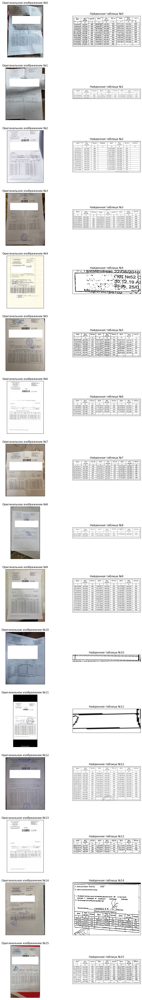

In [19]:
%%time

fig = plt.figure(figsize=(12, 80))
k = 1
for i in range(len(paths_images)):
    image_path = paths_images[i]
    
    fig.add_subplot(16, 2, k)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Оригинальное изображение №{i}')
    k += 1
    
    table_extractor = te0.TableExtractor(image_path)
    perspective_corrected_image = table_extractor.execute()
    fig.add_subplot(16, 2, k)
    plt.imshow(PILImage.fromarray(perspective_corrected_image), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Найденная таблица №{i}')
    k += 1

Видим, что по сравнению с использование исходного класс `TableExtractor` количество правильно извлечённых таблиц значительно увеличилось, с 4 это значение выросло до 12. Однако, этого всё ещё не достаточно. 

Следующей идеей было сделать ещё одну образку изображения, но на этот раз более точную. Для этого мы использовали модель [detr-doc-table-detection](https://huggingface.co/TahaDouaji/detr-doc-table-detection), которая находится область, где располагается таблица. Данная модель не учитывает возможный наклон таблиц на изображениях, поэтому чтобы не обрезать часть таблицы, от координат ограничивающего таблицу прямоугольника, найденного этой моделью, мы решили делать небольшой отступ. По этим координатам вырезаем область, в которой расположена таблица. Протестируем класс `TableExtractor`, в который мы добавили поиск таблицы с импользованием модели `detr-doc-table-detection` (в импортах этот класс записан как `TableExtractor01`). 

In [5]:
%%time
processor = DetrImageProcessor.from_pretrained("TahaDouaji/detr-doc-table-detection")
model = DetrForObjectDetection.from_pretrained("TahaDouaji/detr-doc-table-detection")

The `max_size` parameter is deprecated and will be removed in v4.26. Please specify in `size['longest_edge'] instead`.


CPU times: total: 984 ms
Wall time: 2.6 s


Wall time: 1min 14s


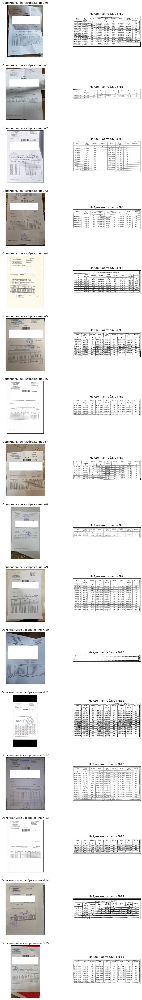

In [21]:
%%time
fig = plt.figure(figsize=(12, 80))
k = 1

for i in range(len(paths_images)):
    image_path = paths_images[i]
    
    fig.add_subplot(16, 2, k)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Оригинальное изображение №{i}')
    k += 1
    
    table_extractor = te01.TableExtractor(image_path, processor, model)
    perspective_corrected_image = table_extractor.execute()
    fig.add_subplot(16, 2, k)
    plt.imshow(PILImage.fromarray(perspective_corrected_image), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Найденная таблица №{i}')
    k += 1  

Видим, что результат работы класса `TableExtractor` после добавления метода извлечения таблицы с использованием модели `detr-doc-table-detection` стал значительно лучше: теперь в 15 из 16 случах таблица из изображения извлекается верно. Однако, стоит отметить, что использование модели `detr-doc-table-detection` увеличило время работы методов класса `TableExtractor` в целом примерно на 60%.

Далее мы разбирались с тем, почему класс `TableExtractor` не правильно извлекает таблицу из изображения 10. Рассмотрим, как наш класс работает с этим изображением на каждом этапе.

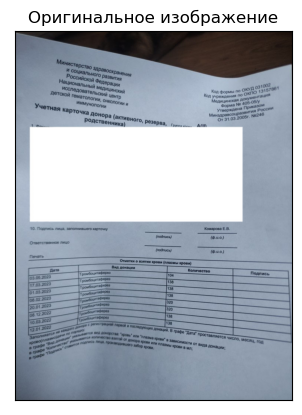

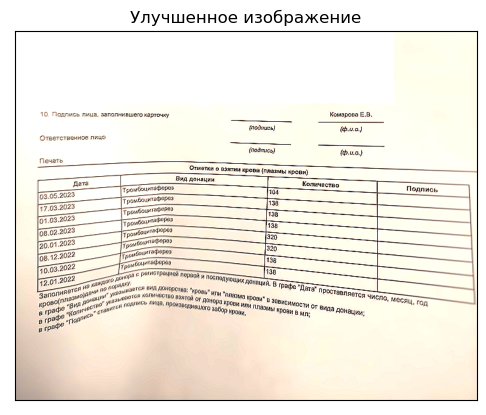

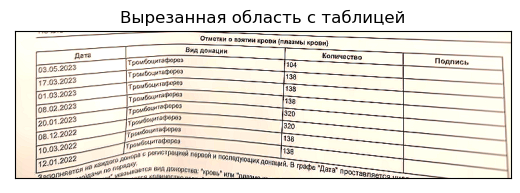

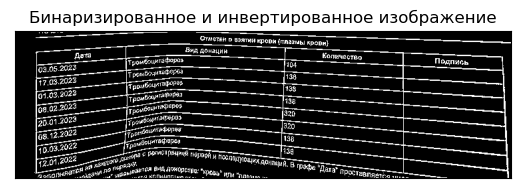

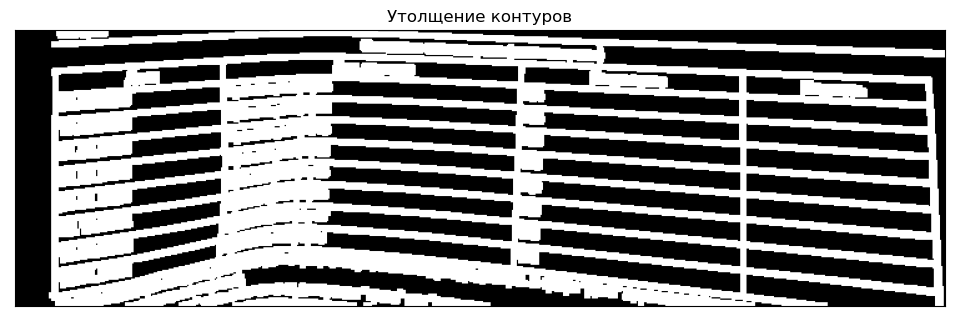

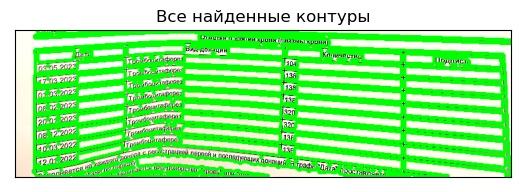

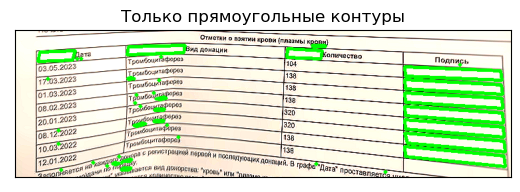

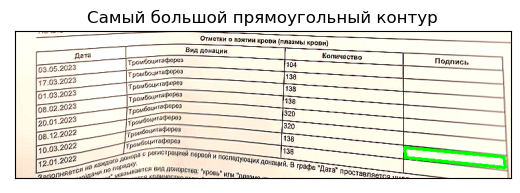

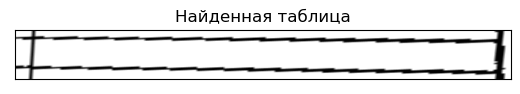

In [22]:
plt.imshow(PILImage.fromarray(images[10]))
plt.xticks([])
plt.yticks([])
plt.title('Оригинальное изображение')
plt.show()

table_extractor = te01.TableExtractor(paths_images[10], processor, model)
perspective_corrected_image = table_extractor.execute()

plt.imshow(PILImage.fromarray(table_extractor.improved_image))
plt.xticks([])
plt.yticks([])
plt.title('Улучшенное изображение')
plt.show()

plt.imshow(PILImage.fromarray(table_extractor.cut_table_image))
plt.xticks([])
plt.yticks([])
plt.title('Вырезанная область с таблицей')
plt.show() 

plt.imshow(PILImage.fromarray(table_extractor.inverted_image), cmap='gray')
plt.xticks([])
plt.yticks([])
plt.title('Бинаризированное и инвертированное изображение')
plt.show() 

fig = plt.figure(figsize=(12, 10))
plt.imshow(PILImage.fromarray(table_extractor.dilated_image), cmap='gray')
plt.xticks([])
plt.yticks([])
plt.title('Утолщение контуров')
plt.show() 

plt.imshow(PILImage.fromarray(table_extractor.image_with_all_contours), cmap='gray')
plt.xticks([])
plt.yticks([])
plt.title('Все найденные контуры')
plt.show()

plt.imshow(PILImage.fromarray(table_extractor.image_with_only_rectangular_contours), cmap='gray')
plt.xticks([])
plt.yticks([])
plt.title('Только прямоугольные контуры')
plt.show() 

plt.imshow(PILImage.fromarray(table_extractor.image_with_contour_with_max_area), cmap='gray')
plt.xticks([])
plt.yticks([])
plt.title('Самый большой прямоугольный контур')
plt.show() 

plt.imshow(PILImage.fromarray(perspective_corrected_image), cmap='gray')
plt.xticks([])
plt.yticks([])
plt.title('Найденная таблица')
plt.show() 

По изображению с утолщением контуров видно, что контур таблицы после утолщения слился со скобкой ")" в названии таблицы, которая в свою очередь тажке соединилась с линией, которая расположена над названием таблицы. Получается, что контур таблицы после такого слияния уже не будет распознан методами `OpenCV`, как прямоугольный, соответственно и найден он не будет.

Решили мы эту проблему следующим образом. По умолчанию в функцию `cv2.dilate` из библиотеки `OpenCV`, которая утолщает контуры, подаётся параметр `iterations=2`. Однако в том случае, если площаль внутри найденного наибольшего прямоугольного контура меньше, чем *0.06 * высота оригинального изображения * 0.5 * ширина оригинального изображения*, то мы устанавливаем параметр `iterations=1` и повторно выполняем поиск контуров на изображении. 

Посмотрим, как работает класс `TableExtractor` после добавления указанного улучшения; это окончательный вариант класса (в импортах записан как `TableExtractor`). 

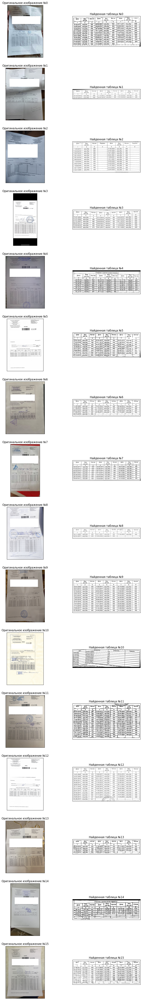

In [106]:
fig = plt.figure(figsize=(12, 80))
k = 1
processor = DetrImageProcessor.from_pretrained("TahaDouaji/detr-doc-table-detection")
model = DetrForObjectDetection.from_pretrained("TahaDouaji/detr-doc-table-detection")

for i in range(len(paths_images)):
    image_path = original_dir + f'{i}' + '.jpg'
    fig.add_subplot(16, 2, k)
    plt.imshow(PILImage.fromarray(images[i]))
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Оригинальное изображение №{i}')
    k += 1
    
    
    table_extractor = te.TableExtractor(image_path, processor, model)
    perspective_corrected_image = table_extractor.execute()
    fig.add_subplot(16, 2, k)
    plt.imshow(PILImage.fromarray(perspective_corrected_image), cmap='gray')
    plt.xticks([])
    plt.yticks([])
    plt.title(f'Найденная таблица №{i}')
    k += 1  

Мы убедились, что теперь наш класс `TableExtractor` правильно извлекает таблицы со всех предоставленный изображений.

## Извлечение таблицы из изображения

Мы решили сравнить, отличается ли качество извлечённых таблиц, если извлекать их из бинаризированных изображений, что делает класс `TableExtractor` (в импортах указан также), и если извлекать таблицы из предобработанных, но не бинаризированных изображений, что делает тот же класс, но немного модифицированный (в импортах указан как `TableExtractor1`).

Изображение таблицы мы извлекаем с помощью класса `TableExtractor`.

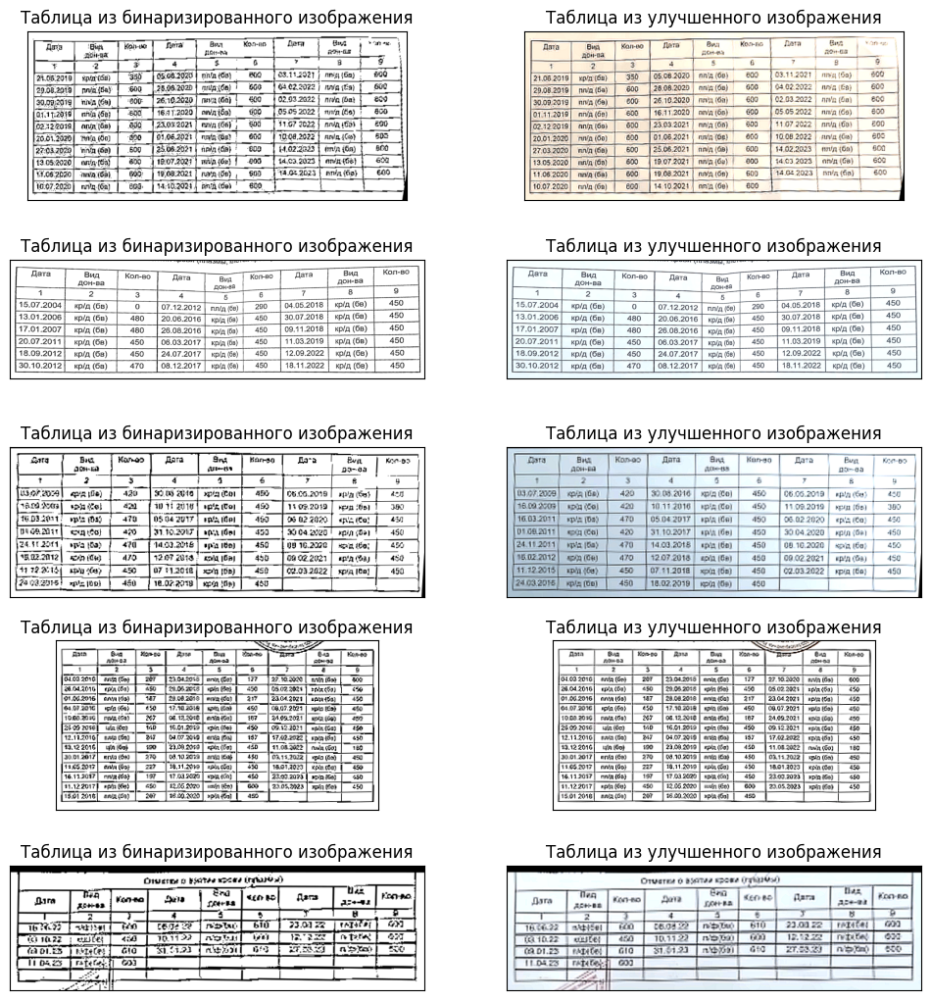

In [59]:
fig = plt.figure(figsize=(12, 13))
k = 1
for i in range(len(paths_images)):
    image_path = original_dir + f'{i}' + '.jpg'
    table_extractor = te.TableExtractor(image_path, processor, model)
    perspective_corrected_image1 = table_extractor.execute()
    cv2.imwrite(results_te + f'{i}' + '.jpg', perspective_corrected_image1)  

    table_extractor = te1.TableExtractor(image_path, processor, model)
    perspective_corrected_image2 = table_extractor.execute()
    cv2.imwrite(results_te1 + f'{i}' + '.jpg', perspective_corrected_image2)   
        
    if i in [0, 3, 5, 11, 14]:
        fig.add_subplot(5, 2, k)
        plt.imshow(PILImage.fromarray(perspective_corrected_image1), cmap='gray')
        plt.xticks([])
        plt.yticks([])
        plt.title('Таблица из бинаризированного изображения')
        k += 1
        
        fig.add_subplot(5, 2, k)
        plt.imshow(PILImage.fromarray(perspective_corrected_image2), cmap='gray')
        plt.xticks([])
        plt.yticks([])
        plt.title('Таблица из улучшенного изображения')
        k += 1

Видно, что на некоторый бинаризованных изображениях качество изображения хуже, чем на не бинаризованных, особенно это заметно на изображениях, которые изначально были не очень хорошего качества.

## Распознавание информации в таблице с помощью библиотек img2table + EasyOCR

Теперь после того, как таблицы были извлечены, можно приступить к их распознаванию. Распознавать таблицы мы будем с помощью библиотеки `img2table` и  `EasyOCR`.

Будем проверять эффективность работы двух классов: TableExtractor, который выдает бинаризованное изображение и TableExtractor1, который выдает не бинаризованное изображение.

In [60]:
# сохраняю таблицы exel в папке results/te/ после работы класса TableExtractor
prep_im = [i for i in os.listdir(results_te) if 'jpg' in i]
for num in range(len(prep_im)):
        doc = Image(results_te + f"{num}" + '.jpg')
        ocr = EasyOCR(lang=["ru"])
        doc.to_xlsx(results_te + f"table_{num}" + '.xlsx',
                ocr=ocr,
                implicit_rows=False,
                borderless_tables=False)

In [61]:
# результат распознавания таблиц с помощью класса TableExtractor
for i in [1,5,7]:
    print(f'ПРИМЕР {i}')
    print(tabulate(pd.read_excel(results_te + f"table_{i}" + '.xlsx'), headers='keys'), '\n')

ПРИМЕР 1
    Дата              Вид    Кол-во  Дата.1      Вид           Кол-во.1  Дата.2      Вид           Кол-во.2
                   дон-ва                        дон-ва.1                            дон-ва.2
--  -----------  --------  --------  ----------  ----------  ----------  ----------  ----------  ----------
 0  nan                 2         3  nan         5                    6  nan         8                    9
 1  01.04.2015        nan       450  11.10.2017  кр/д (бв)          450  16.10.2018  круд (бв)          450
 2  27.07.201-7       nan       450  30.07.2018  кр/д (бв)          450  15.10.2019  кр/д (бв)          450 

ПРИМЕР 5
    Unnamed: 0    Unnamed: 1    дптз      Unnamed: 3    Unnamed: 4    Unnamed: 5
--  ------------  ------------  --------  ------------  ------------  ------------
 0  nan           nan           nan       #7 ы          45            nan
 1  nan           nan           nan       nan           45)           nan
 2  nan           475           05

In [62]:
# сохраняю таблицы exel в папке results/te1/ после работы класса TableExtractor1
prep_im = [i for i in os.listdir(results_te1) if 'jpg' in i]
for num1 in range(len(prep_im)):
        doc = Image(results_te1 + f"{num1}" + '.jpg')
        ocr = EasyOCR(lang=["ru"])
        doc.to_xlsx(results_te1 + f"table_{num1}" + '.xlsx',
                ocr=ocr,
                implicit_rows=False,
                borderless_tables=False)

In [63]:
# результат распознавания таблиц с помощью класса TableExtractor1
for i in [1,5,7]:
    print(f'ПРИМЕР {i}')
    print(tabulate(pd.read_excel(results_te1 + f"table_{i}" + '.xlsx'), headers='keys'), '\n')

ПРИМЕР 1
    Дата        Вид          Кол-во  Дата.1      Вид           Кол-во.1  Дата.2      Вид           Кол-во.2
                дон-ва                           дон-ва.1                            дон-ва.2
--  ----------  ---------  --------  ----------  ----------  ----------  ----------  ----------  ----------
 0  nan         2                 3  4           5                    6  nan         8                    9
 1  01.04.2015  кр/д (бв)       450  11.10.2017  крод (бв)          450  16.10.2018  кр/д (бв)          450
 2  27.07.2017  nan             450  30.07.2018  кр/д (бв)          450  15.10.2019  кр/д (бв)          450 

ПРИМЕР 5
    Unnamed: 0      а4;    Unnamed: 2  Unnamed: 3    Unnamed: 4
--  ------------  -----  ------------  ------------  ------------
 0  nan             nan           nan  nan           '-
 1  nan             nan           nan  м1 155]       157
 2  з1алт           nan           157  nan           nan 

ПРИМЕР 7
    Дата        Вид          Кол-во

Для сравнения возьмем три одинаковых изображения с таблицами (№1, №5 и № 7). Изображение, представленное в Примерах 1 и 5, распознается достаточно хорошо обоими классами. Есть небельшие отличия в знаках препинания (вместо точки может быть распознана запятая), буквы путаются с символами ("/" может быть распознан как буква). 

Изображение из Примера 5 распознается одинаково плохо обоими классами. Это связано с тем, что изображение из данного примера имеет плохое качество. 

## Пример работы TableToCsv

In [64]:
# пример работы TableToCsv на классе TableExtractor
table_list = [i for i in os.listdir(results_te) if 'xlsx' in i]

for num in range(len(table_list)):
    path = results_te + f"table_{num}"  + '.xlsx'
    save_path = results_te + f"csv_table_{num}"  + '.csv'
    try:
        table_to_csv = ta.TableToCsv(path, save_path)
        table = table_to_csv.result()
    except:
        pass

In [65]:
#пример работы класса TableToCsv на результатах работы класса на классе TableExtractor
for i in [1,5,8]:
    try:
        print(tabulate(pd.read_csv(results_te + f"csv_table_{i}"  + '.csv'), headers='keys'))
        print('\n')
    except:
        print('Таблица не распознана')
        print('\n')

    Дата донации      Кол-во  Класс крови    Тип донации
--  --------------  --------  -------------  -------------
 0  01.04.2015           450  Цельная кровь  Безвозмездно
 1  27.07.201.7          450  Цельная кровь  Безвозмездно
 2  11.10.2017           450  Цельная кровь  Безвозмездно
 3  30.07.2018           450  Цельная кровь  Безвозмездно
 4  16.10.2018           450  Цельная кровь  Безвозмездно
 5  15.10.2019           450  Цельная кровь  Безвозмездно


    Дата донации      Кол-во  Класс крови    Тип донации
--  --------------  --------  -------------  -------------
 0  20.03.2019           nan  Цельная кровь  Безвозмездно
 1  23.05.7019           450  Цельная кровь  Безвозмездно
 2  11.09.2019           nan  Цельная кровь  Безвозмездно
 3  92.12.2019           450  Цельная кровь  Безвозмездно
 4  nan                  350  Цельная кровь  Безвозмездно
 5  16.98.2020           450  Цельная кровь  Безвозмездно
 6  21.11.2020           450  Цельная кровь  Безвозмездно
 7  05.03.20

In [66]:
# сохраняю результат работы TableToCsv 
table_list = [i for i in os.listdir(results_te1) if 'xlsx' in i]

for num in range(len(table_list)):
    path = results_te1 + f"table_{num}"  + '.xlsx'
    save_path = results_te1 + f"csv_table_{num}"  + '.csv'
    try:
        table_to_csv = ta.TableToCsv(path, save_path)
        table = table_to_csv.result()
    except:
        pass

In [67]:
#пример работы класса TableToCsv на результатах работы класса на классе TableExtractor1
for i in [1,5,8]:
    try:
        print(tabulate(pd.read_csv(results_te1 + f"csv_table_{i}"  + '.csv'), headers='keys'))
        print('\n')
    except:
        print('Таблица не распознана')
        print('\n')

    Дата донации      Кол-во  Класс крови    Тип донации
--  --------------  --------  -------------  -------------
 0  01.04.2015           450  Цельная кровь  Безвозмездно
 1  27.07.2017           450  Цельная кровь  Безвозмездно
 2  11.10.2017           450  Цельная кровь  Безвозмездно
 3  30.07.2018           450  Цельная кровь  Безвозмездно
 4  16.10.2018           450  Цельная кровь  Безвозмездно
 5  15.10.2019           450  Цельная кровь  Безвозмездно


    Дата донации      Кол-во  Класс крови    Тип донации
--  --------------  --------  -------------  -------------
 0  20.03.2019           450  Цельная кровь  Безвозмездно
 1  23.05.2019           450  Цельная кровь  Безвозмездно
 2  .09.2019             nan  Цельная кровь  Безвозмездно
 3  92.12.2019           450  Цельная кровь  Безвозмездно
 4  11.06.2020           350  Цельная кровь  Безвозмездно
 5  16.98.2020           450  Цельная кровь  Безвозмездно
 6  27.11.2020           450  Цельная кровь  Безвозмездно
 7  05.03.20

Принцип работы основан на поиске определенных сечетаний букв. Например, если на фото или в экселе в колонке "Вид дон-ва" указано кр/д (бв), то класс TableToCsv переведет данную информацию в Класс крови - Цельная кровь (кр/д), а Тип донации - Безвозмездно (бв). Есть и другие обозначения для определения Класса крови: пл/д - Плазма, т/ф - Тромбоциты. Также класс TableToCsv приводит к нужному виду Дату донации: убирает лишние символы, меняет запятые на точки. 

## Подсчет метрики accuracy

In [111]:
# функция расчета метрики для изображения
def advanced_compare(df1, df2):
    length = min(df1.shape[0], df2.shape[0])
    df1 = df1.iloc[:length]
    df2 = df2.iloc[:length]
    counter = 0
    for i in range(df1.shape[0]):
        for j in range(df1.shape[1]):
            if df1.iloc[i, j] == df2.iloc[i, j]:
                counter += 1
    return round(counter / (df1.shape[0] * df1.shape[1]) * 100, 2)

In [112]:
# сохраняю метрику в список list_te для обработанных изображений (класс)
list_te = []

for i in range(len(paths_images)):
    try:
        df1 = pd.read_csv(original_dir + f'{i}.csv')[['Дата донации', 'Тип донации', 'Класс крови']]
        df2 = pd.read_csv(results_te + f'csv_table_{i}.csv')[['Дата донации', 'Тип донации', 'Класс крови']]
        list_te.append(advanced_compare(df1, df2))
    except:
        list_te.append(0)

In [113]:
# метрика accuracy для каждого изображения (TableExtractor)
pd.Series(list_te)

0      35.90
1      94.44
2     100.00
3      64.81
4      58.33
5       0.00
6      97.44
7       0.00
8     100.00
9     100.00
10      0.00
11      0.00
12     86.11
13     78.79
14      0.00
15      0.00
dtype: float64

In [114]:
# среднее значение метрики (TableExtractor)
statistics.mean(list_te)

50.98875

In [115]:
list_te1 = []

for i in range(len(paths_images)):
    try:
        df1 = pd.read_csv(original_dir + f'{i}.csv')[['Дата донации', 'Тип донации', 'Класс крови']]
        df2 = pd.read_csv(results_te1+ f'csv_table_{i}.csv')[['Дата донации', 'Тип донации', 'Класс крови']]
        list_te1.append(advanced_compare(df1, df2))
    except:
        list_te1.append(0)

In [116]:
# среднее значение метрики (TableExtractor1)
statistics.mean(list_te1)

52.620625

In [117]:
# метрика accuracy для каждого изображения (TableExtractor1)
pd.Series(list_te1)

0      39.39
1     100.00
2      98.48
3      64.81
4      58.33
5       0.00
6     100.00
7       0.00
8     100.00
9     100.00
10      0.00
11      0.00
12     99.10
13     81.82
14      0.00
15      0.00
dtype: float64

Для двух классов предобработки значения метрик немного отличаются.

In [118]:
# Сравнительный анализ метрик для каждой картинки
pd.concat([pd.Series(list_te), pd.Series(list_te1)], axis=1).rename(columns={0: 'TableExtractor', 1:'TableExtractor1'})

,TableExtractor,TableExtractor1
0,35.90,39.39
1,94.44,100.00
2,100.00,98.48
3,64.81,64.81
4,58.33,58.33
5,0.00,0.00
6,97.44,100.00
7,0.00,0.00
8,100.00,100.00
9,100.00,100.00


Из сравнительной таблицы классов TableExtractor и TableExtractor1 видно, что TableExtractor1 чаще дает более высокое значение метрики accuracy, то есть в среднем работает лучше класса TableExtractor. Отсуда можно сделать вывод о том, что не бинаризированное изображение распознается лучше чем бинаризированное.

## Выводы

В ходе работы были исследована библиотека img2table с двумя различными вариантами OCR: Tesseract и EasyOCR. Лучше всего с поставленной задачей справляется EasyOCR, однако без предварительной обработки распознавание таблиц работает плохо, поэтому нужно будет предобрабатывать изображения. Для предобработки и выделения таблицы из фото было реализовано два класса: TableExtractor и TableExtractor1 (TableExtractor выдает бинаризированное изображение, для TableExtractor1 таблица извлекается из предобработанного, но не бинаризированного изображения). Далее таблицы обрабатывались с помощью img2table и EasyOCR, далее формировались exel таблицы. Так как exel таблицы и таблицы на фото имели разные форматы, то с помощью класса TableToCsv exel приводились к единому образца.

Завершаюшим этапов работы была проверка значения метрики accuracy на полученных от заказчика csv файлах. Класс предобработки TableExtractor показал значение метрики около **51%**, а TableExtractor1 - около **53%**. 

В результате данной работы можно сделать вывод о том, что на факт распознавания изображения в первую очередь влияет качество самого изображения. Лучше всего распознаются светлые изображения с равномерным освещением и четким текстом в таблице. Также не бинаризированное изображение распознается лучше чем бинаризированное.